In [5]:
import pandas as pd
from ydata_profiling import ProfileReport
from ydata_profiling.config import Config
import plotly.express as px
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, FunctionTransformer
from category_encoders import TargetEncoder

from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import classification_report

## Read in Depression Dataset

In [6]:
data = pd.read_csv("../data/depression_data.csv", index_col="Name")

In [7]:
data.columns

Index(['Age', 'Marital Status', 'Education Level', 'Number of Children',
       'Smoking Status', 'Physical Activity Level', 'Employment Status',
       'Income', 'Alcohol Consumption', 'Dietary Habits', 'Sleep Patterns',
       'History of Mental Illness', 'History of Substance Abuse',
       'Family History of Depression', 'Chronic Medical Conditions'],
      dtype='object')

## Profile dataset as initial EDA

In [8]:
profile = ProfileReport(data, 
                        title="Profiling Report", explorative=True,  
                        correlations={
                            "cramers": {"calculate": True},
                            "auto": {"calculate": False},
                            "pearson": {"calculate": True},
                            "spearman": {"calculate": True},
                            "phi_k": {"calculate": True},
                                            
                        },)

In [9]:
profile.to_file("output.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Deep Dive EDA

From the profile report, we observe that:

Age is highly correlated with Marital Status and Number of Children <br>
Income is highly correlated with Education Level and Employment Status <br>
Physical Activity Level is highly correlated with Dietary Habits

### Relationship between Mental Illness and Income
The relationship between Mental illness and income is unclear from the profile so we shall deep dive here

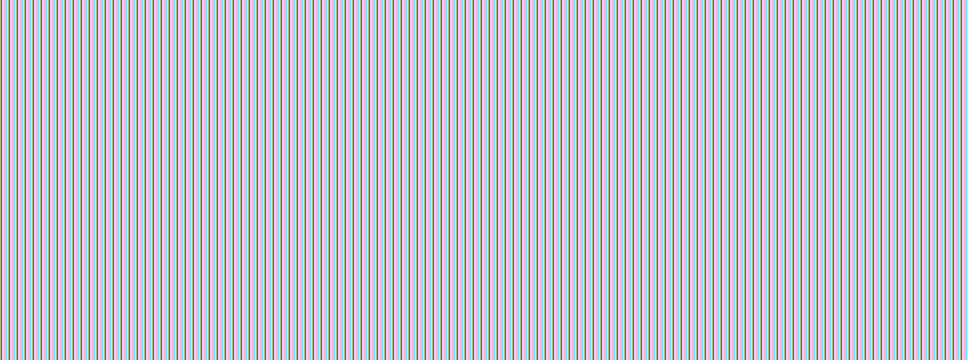

In [10]:
px.box(data, x="History of Mental Illness", y="Income")

We have found that there is a marginal effect - an increase in income tends to reduce the prevalence of mental illness, but with some outliers at the much higher incomes

### Relationship between Mental Illness and Age

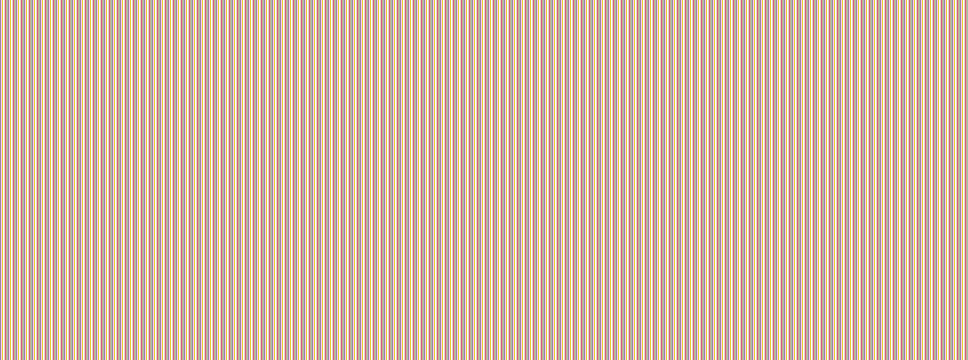

In [12]:
px.box(data, x="History of Mental Illness", y="Age")

We find that age by itself is not a strong indicator of mental illness as the box plots are nearly identical

# Model Building

### Test Train Split

In [13]:
X = data.drop(columns=['History of Mental Illness'])
y = data['History of Mental Illness'].map({"Yes": 1, "No": 0})

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=4)

### Feature Engineering

#### Categorical encoding
We shall encode the categorical features with the average response for their groups

In [17]:
categorical_preprocessor = Pipeline(steps=[
    ('target_encoder', TargetEncoder(
        cols=['Marital Status', "Sleep Patterns", "Alcohol Consumption", "Physical Activity Level"])
    ),
])

#### Binary encoding
We shall encode the binary features with One Hot Encoding, dropping the first column

In [18]:
binary_preprocessor = Pipeline(steps=[
    ("one_hot_encoder", OneHotEncoder(drop='first'))
])

#### Numerical processing
We do nothing to the numerical features

In [19]:
numerical_preprocessor = Pipeline(steps=[
    ("identity", FunctionTransformer(lambda x: x, feature_names_out='one-to-one'))
])

### Creating the pipeline

In [20]:
preprocessor = ColumnTransformer(
    transformers=[
        ('categorical', categorical_preprocessor, ['Marital Status', "Sleep Patterns", "Alcohol Consumption", "Physical Activity Level"]),
        ('binary', binary_preprocessor, ['History of Substance Abuse', 'Family History of Depression', "Chronic Medical Conditions"]),
        ('numerical', numerical_preprocessor, ['Age', 'Income'])
    ],
    remainder='drop'
)

In [21]:
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor)
])

In [22]:
pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('categorical',
                                                  Pipeline(steps=[('target_encoder',
                                                                   TargetEncoder(cols=['Marital '
                                                                                       'Status',
                                                                                       'Sleep '
                                                                                       'Patterns',
                                                                                       'Alcohol '
                                                                                       'Consumption',
                                                                                       'Physical '
                                                                                       'Activity '
                                                                                       'Level']))]),
                                                  ['Marital Status',
                                                   'Sleep Patterns',
                                                   'Alcohol Consumption',
                                                   'Physical Activity Level']),
                                                 ('binary',
                                                  Pipeline(steps=[('one_hot_encoder',
                                                                   OneHotEncoder(drop='first'))]),
                                                  ['History of Substance Abuse',
                                                   'Family History of '
                                                   'Depression',
                                                   'Chronic Medical '
                                                   'Conditions']),
                                                 ('numerical',
                                                  Pipeline(steps=[('identity',
                                                                   FunctionTransformer(feature_names_out='one-to-one',
                                                                                       func=<function <lambda> at 0xffff403d4ea0>))]),
                                                  ['Age', 'Income'])]))])

In [23]:
X_train_transformed = pd.DataFrame(pipeline.transform(X_train), columns=pipeline.get_feature_names_out())

In [24]:
X_test_transformed = pd.DataFrame(pipeline.transform(X_test), columns=pipeline.get_feature_names_out())

## Training the Model

In [25]:
classifier = GradientBoostingClassifier()

In [26]:
classifier.fit(X_train_transformed, y_train)

GradientBoostingClassifier()

In [27]:
print(classification_report(y_train, classifier.predict(X_train_transformed)))

              precision    recall  f1-score   support

           0       0.70      1.00      0.82    230461
           1       1.00      0.00      0.00    100553

    accuracy                           0.70    331014
   macro avg       0.85      0.50      0.41    331014
weighted avg       0.79      0.70      0.57    331014



In [85]:
print(classification_report(y_test, classifier.predict(X_test_transformed)))

              precision    recall  f1-score   support

           0       0.69      1.00      0.82     57482
           1       0.22      0.00      0.00     25272

    accuracy                           0.69     82754
   macro avg       0.46      0.50      0.41     82754
weighted avg       0.55      0.69      0.57     82754

